implementing an improved dcgan

https://github.com/llSourcell/Pokemon_GAN/blob/master/Generative%20Adversarial%20Networks.ipynb

https://github.com/pytorch/examples/blob/master/dcgan/main.py

https://github.com/yunjey/pytorch-tutorial/tree/master/tutorials/03-advanced/deep_convolutional_gan

https://github.com/yvan/face-generation/blob/master/dlnd_face_generation.ipynb

https://docs.opencv.org/3.3.1/d5/d69/tutorial_py_non_local_means.html

Failure modes:

mode collapse - genreator outputs similar images, form of overfitting?

small gradients - discriminator goes to near 0 instantly - not enough gradient info for generator to make a good image

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
from torch.utils import data
from torchvision.datasets import ImageFolder
from torchvision import transforms, datasets
from torchvision.utils import make_grid

In [3]:
torch.cuda.is_available(), torch.__version__, torch.cuda.device_count()

(True, '0.2.0_4', 1)

In [4]:
# params
n_epochs = 125
batch_size = 64
lr = 0.0002
label_smooth = 0.9
pokemon_models = os.path.join('/scratch', 'yns207', 'pokemon_models')
image_path = os.path.join('/scratch','yns207','imgs','pokemon')
mnist_img = os.path.join('/scratch','yns207', 'imgs', 'mnist')
# params generator
noise_dim = 100
g_filter_depth = 64
# params discriminator
d_filter_depth_in = 3
d_filter_depth = 64
# loss limits
gen_loss_limit = 0.6
disc_loss_limit = 0.45

In [5]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(noise_dim, 
                              512, 
                              kernel_size=4, 
                              stride=1, 
                              padding=0,
                              bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(),

            nn.ConvTranspose2d(512, 
                              256, 
                              kernel_size=4, 
                              stride=2,
                              padding=1,
                              bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            
            nn.ConvTranspose2d(256, 
                              128, 
                              kernel_size=4, 
                              stride=2, 
                              padding=1,
                              bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            
            nn.ConvTranspose2d(128, 
                              64, 
                              kernel_size=4, 
                              stride=2, 
                              padding=1,
                              bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            
            nn.ConvTranspose2d(64, 
                               d_filter_depth_in,
                               kernel_size=4,
                               stride=2,
                               padding=1,
                               bias=False),
            nn.Tanh()
        )
        
    def forward(self, inputs):
        # add two single dimensions
        output = self.main(inputs)
        return output

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(in_channels=d_filter_depth_in, 
                      out_channels=64, 
                      kernel_size=4, 
                      stride=2,
                      padding=1,
                      bias=False),
            nn.LeakyReLU(0.2),

            nn.Conv2d(in_channels=64, 
                      out_channels=128, 
                      kernel_size=3, 
                      stride=2,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(in_channels=128, 
                      out_channels=256, 
                      kernel_size=4, 
                      stride=2,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            
            nn.Conv2d(in_channels=256, 
                      out_channels=512, 
                      kernel_size=4, 
                      stride=2,
                      padding=1,
                      bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            
            nn.Conv2d(in_channels=512, 
                      out_channels=1, 
                      kernel_size=4, 
                      stride=1,
                      padding=0,
                      bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, inputs):
        output = self.main(inputs)
        return output.view(-1, 1).squeeze(1)

In [6]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv2d') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:
        m.weight.data.normal_(1.0,0.02)
        m.bias.data.fill_(0)
        
def to_variable(x):
    '''
    convert a tensor to a variable
    with gradient tracking
    '''
    if torch.cuda.is_available():
        x = x .cuda()
    return Variable(x)

def denorm_monsters(x):
    '''
    convert images to be (0, 1)
    '''
    renorm = (x*0.5)+0.5
    return renorm.clamp(0,1)

def denorm_mnist(x):
    '''
    convert images to be (0, 1)
    '''
    renorm = (x*0.3081)+0.1307
    return renorm.clamp(0,1)

def noise_labels(shape):
    if torch.rand(1)[0] > 0.5:
        return to_variable(torch.ones(shape))
    else:
        return to_variable(torch.zeros(shape))
    
smooth_pos = to_variable(torch.randn(batch_size, noise_dim))
smooth_neg = to_variable(torch.randn(batch_size, noise_dim))

In [7]:
mnist_transform = transforms.Compose([
        transforms.Scale(64),
        transforms.ToTensor(),
        transforms.Normalize((0.1307,), (0.3081,))
        ])

mnist_dataset = datasets.MNIST(mnist_img, download=True, transform=mnist_transform)

mnist_loader = data.DataLoader(dataset=mnist_dataset, 
                              batch_size=batch_size,
                              shuffle=True,
                              num_workers=2)


monster_transform = transforms.Compose([
#          transforms.Lambda(lambda x: x.convert('L')),
         transforms.Scale(64),
         transforms.CenterCrop(64),
         transforms.ToTensor(), 
         transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)),
        ])
monster_dataset = ImageFolder(image_path, monster_transform)
monster_loader = data.DataLoader(dataset=monster_dataset, 
                              batch_size=batch_size,
                              shuffle=True,
                              num_workers=2)

In [8]:
loss_func = nn.BCELoss()
generator = Generator()
generator = generator.apply(weights_init)

discriminator = Discriminator()
discriminator = discriminator.apply(weights_init)

d_optimizer = optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.99))
g_optimizer = optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.99))

if torch.cuda.is_available():
    generator.cuda()
    discriminator.cuda()
    loss_func.cuda()
    
data_loader = monster_loader
denorm = denorm_monsters

In [9]:
fixed_noise = to_variable(torch.randn(batch_size, noise_dim, 1, 1))

epoch 0
generator loss: 7.13, dis loss real: 0.82, dis loss fake: 1.86


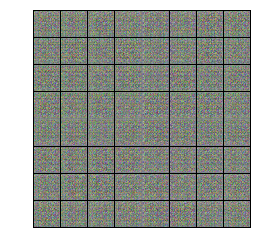

epoch 1
generator loss: 12.42, dis loss real: 0.82, dis loss fake: 0.83


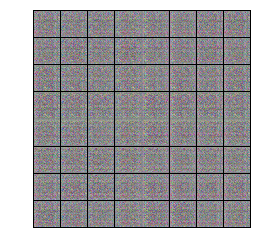

epoch 2
generator loss: 13.35, dis loss real: 0.81, dis loss fake: 1.11


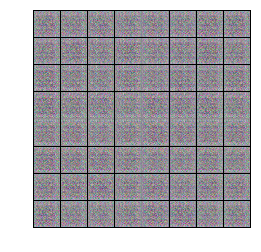

epoch 3
generator loss: 12.25, dis loss real: 0.81, dis loss fake: 1.21


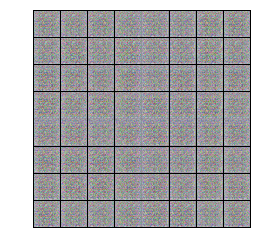

epoch 4
generator loss: 12.09, dis loss real: 0.88, dis loss fake: 0.70


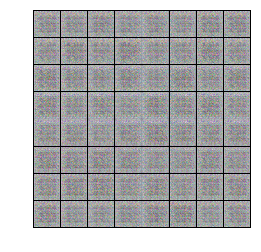

epoch 5
generator loss: 9.10, dis loss real: 1.20, dis loss fake: 0.96


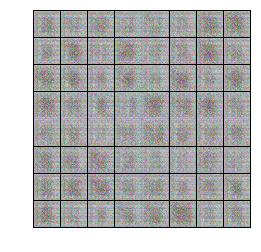

epoch 6
generator loss: 6.07, dis loss real: 1.32, dis loss fake: 0.90


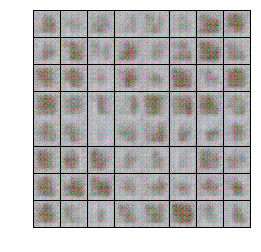

epoch 7
generator loss: 4.00, dis loss real: 1.05, dis loss fake: 0.86


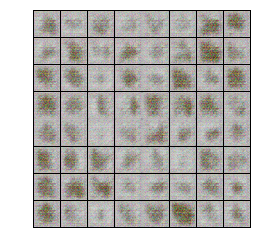

epoch 8
generator loss: 3.35, dis loss real: 0.89, dis loss fake: 0.53


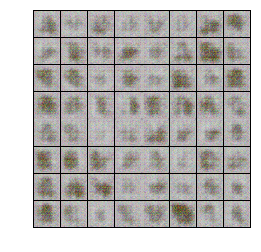

epoch 9
generator loss: 3.37, dis loss real: 0.77, dis loss fake: 0.48


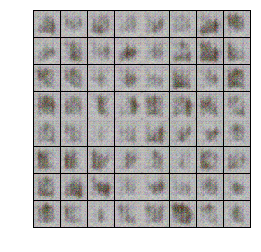

epoch 10
generator loss: 3.55, dis loss real: 0.73, dis loss fake: 0.49


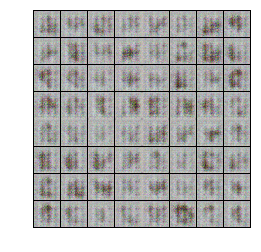

epoch 11
generator loss: 3.85, dis loss real: 0.85, dis loss fake: 0.46


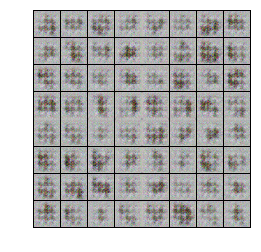

epoch 12
generator loss: 4.00, dis loss real: 0.63, dis loss fake: 0.42


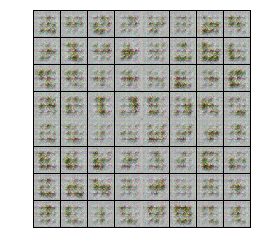

epoch 13
generator loss: 4.64, dis loss real: 0.68, dis loss fake: 0.43


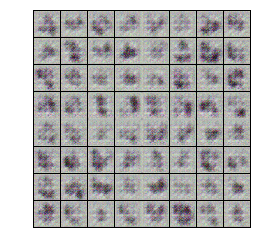

epoch 14
generator loss: 3.63, dis loss real: 0.60, dis loss fake: 0.26


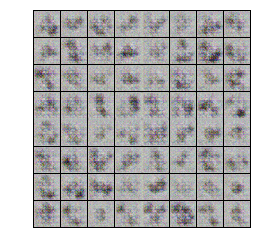

epoch 15
generator loss: 3.51, dis loss real: 0.53, dis loss fake: 0.29


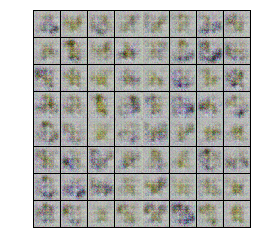

epoch 16
generator loss: 3.06, dis loss real: 0.86, dis loss fake: 0.52


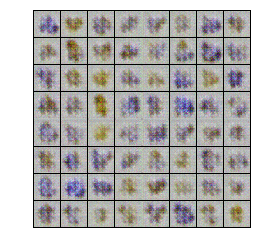

epoch 17
generator loss: 2.65, dis loss real: 0.83, dis loss fake: 0.46


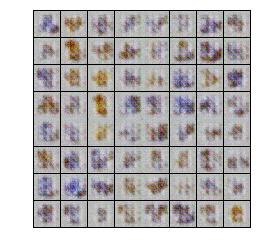

epoch 18
generator loss: 2.63, dis loss real: 0.64, dis loss fake: 0.45


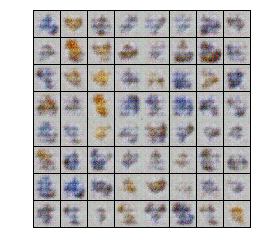

epoch 19
generator loss: 2.44, dis loss real: 0.75, dis loss fake: 0.41


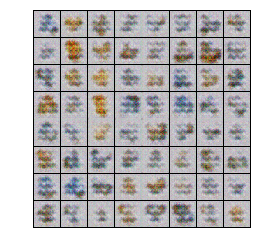

epoch 20
generator loss: 2.63, dis loss real: 0.61, dis loss fake: 0.33


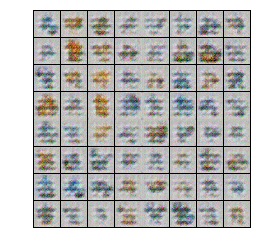

epoch 21
generator loss: 2.64, dis loss real: 0.80, dis loss fake: 0.49


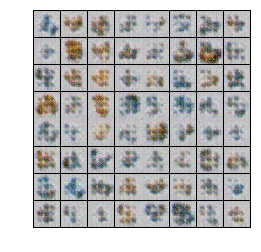

epoch 22
generator loss: 2.61, dis loss real: 0.67, dis loss fake: 0.37


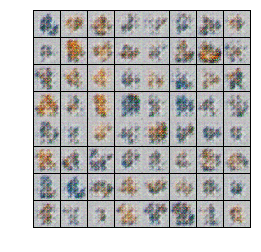

epoch 23
generator loss: 2.69, dis loss real: 0.80, dis loss fake: 0.40


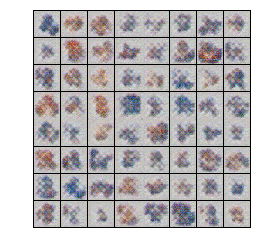

epoch 24
generator loss: 2.96, dis loss real: 0.63, dis loss fake: 0.41


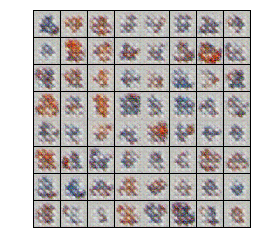

epoch 25
generator loss: 3.23, dis loss real: 0.61, dis loss fake: 0.39


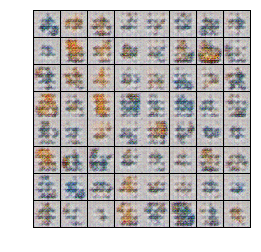

epoch 26
generator loss: 3.18, dis loss real: 0.84, dis loss fake: 0.50


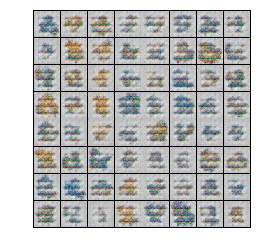

epoch 27
generator loss: 2.81, dis loss real: 0.64, dis loss fake: 0.36


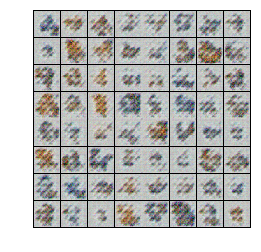

epoch 28
generator loss: 3.03, dis loss real: 0.71, dis loss fake: 0.44


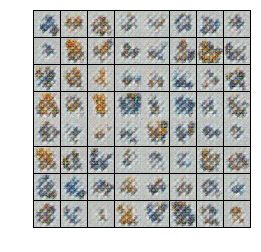

epoch 29
generator loss: 2.87, dis loss real: 0.74, dis loss fake: 0.48


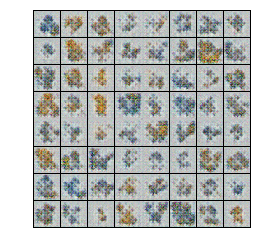

epoch 30
generator loss: 3.06, dis loss real: 0.60, dis loss fake: 0.41


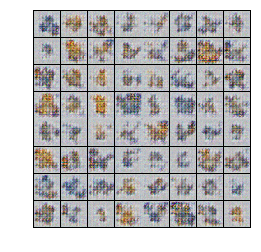

epoch 31
generator loss: 2.63, dis loss real: 0.81, dis loss fake: 0.35


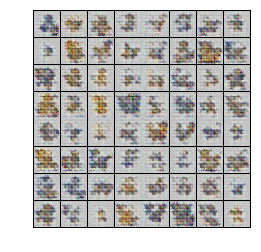

epoch 32
generator loss: 3.13, dis loss real: 0.85, dis loss fake: 0.53


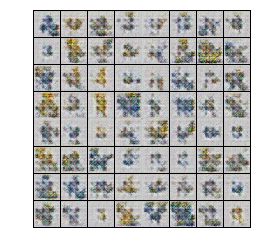

epoch 33
generator loss: 3.20, dis loss real: 0.72, dis loss fake: 0.47


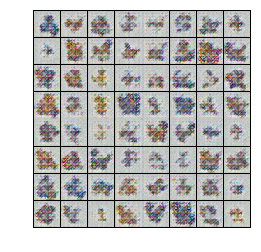

epoch 34
generator loss: 2.95, dis loss real: 0.69, dis loss fake: 0.39


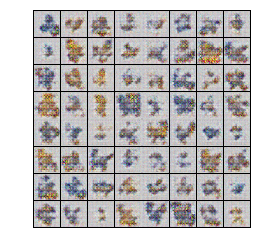

epoch 35
generator loss: 2.95, dis loss real: 0.68, dis loss fake: 0.41


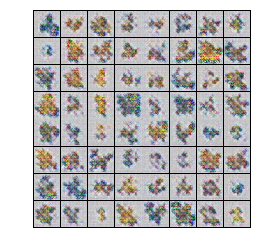

epoch 36
generator loss: 2.86, dis loss real: 0.84, dis loss fake: 0.44


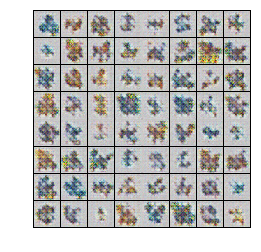

epoch 37
generator loss: 2.61, dis loss real: 0.58, dis loss fake: 0.34


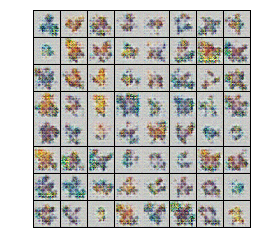

epoch 38
generator loss: 2.95, dis loss real: 0.67, dis loss fake: 0.44


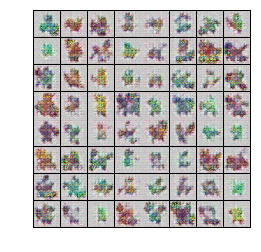

epoch 39
generator loss: 3.02, dis loss real: 0.73, dis loss fake: 0.42


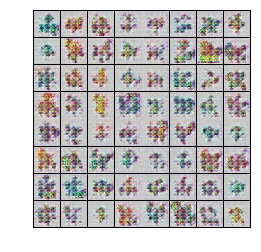

epoch 40
generator loss: 3.03, dis loss real: 0.58, dis loss fake: 0.32


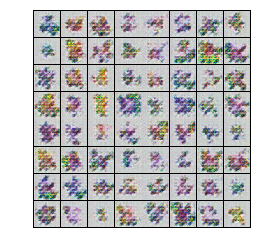

epoch 41
generator loss: 3.19, dis loss real: 0.65, dis loss fake: 0.37


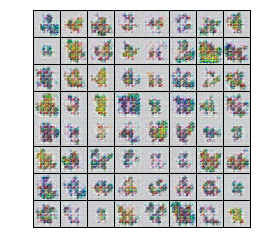

epoch 42
generator loss: 3.01, dis loss real: 0.56, dis loss fake: 0.32


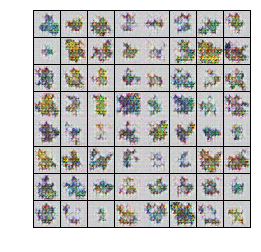

epoch 43
generator loss: 3.44, dis loss real: 0.97, dis loss fake: 0.47


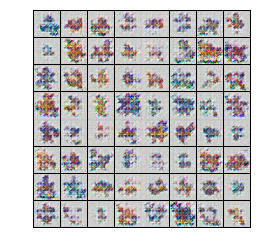

epoch 44
generator loss: 2.64, dis loss real: 0.59, dis loss fake: 0.36


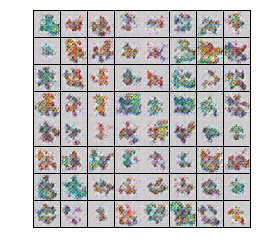

epoch 45
generator loss: 2.72, dis loss real: 0.58, dis loss fake: 0.37


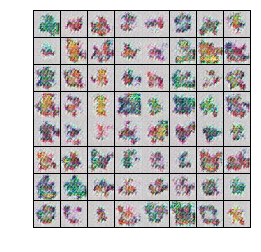

epoch 46
generator loss: 2.93, dis loss real: 0.58, dis loss fake: 0.36


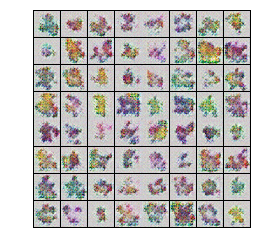

epoch 47
generator loss: 2.81, dis loss real: 0.69, dis loss fake: 0.43


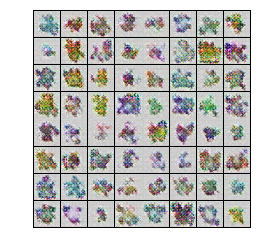

epoch 48
generator loss: 2.83, dis loss real: 0.72, dis loss fake: 0.41


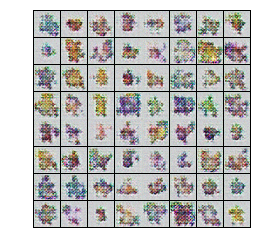

epoch 49
generator loss: 2.75, dis loss real: 0.74, dis loss fake: 0.38


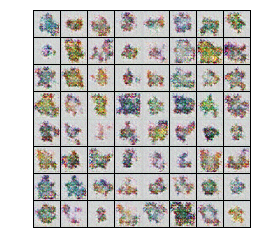

epoch 50
generator loss: 2.82, dis loss real: 0.60, dis loss fake: 0.39


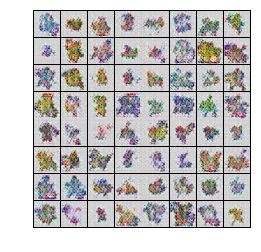

epoch 51
generator loss: 2.94, dis loss real: 0.68, dis loss fake: 0.43


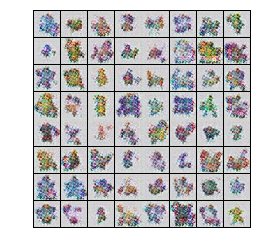

epoch 52
generator loss: 2.75, dis loss real: 0.68, dis loss fake: 0.34


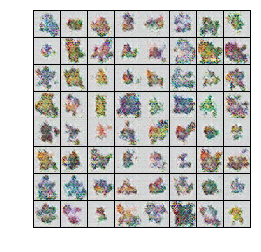

epoch 53
generator loss: 2.89, dis loss real: 0.65, dis loss fake: 0.40


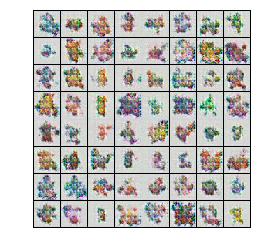

epoch 54
generator loss: 3.28, dis loss real: 0.58, dis loss fake: 0.43


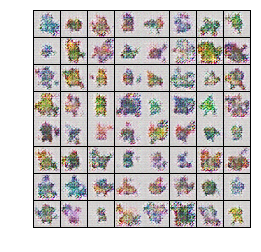

epoch 55
generator loss: 3.05, dis loss real: 0.68, dis loss fake: 0.35


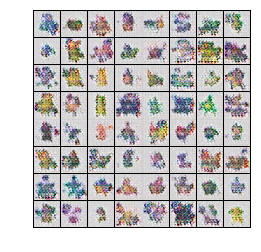

epoch 56
generator loss: 3.02, dis loss real: 0.51, dis loss fake: 0.30


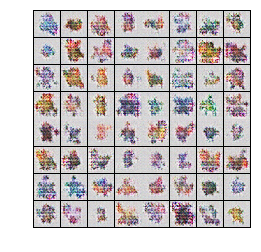

epoch 57
generator loss: 2.87, dis loss real: 0.86, dis loss fake: 0.46


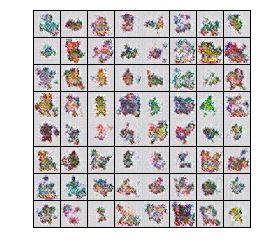

epoch 58
generator loss: 2.60, dis loss real: 0.56, dis loss fake: 0.32


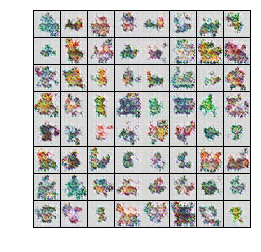

epoch 59
generator loss: 3.05, dis loss real: 0.72, dis loss fake: 0.38


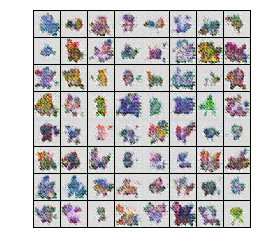

epoch 60
generator loss: 2.80, dis loss real: 0.51, dis loss fake: 0.32


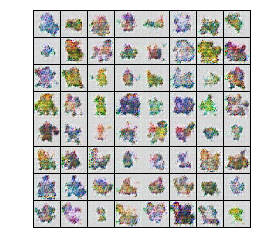

epoch 61
generator loss: 2.98, dis loss real: 0.62, dis loss fake: 0.35


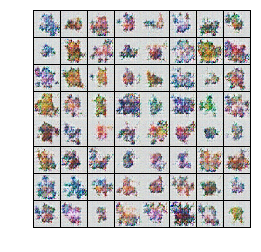

epoch 62
generator loss: 3.07, dis loss real: 0.57, dis loss fake: 0.33


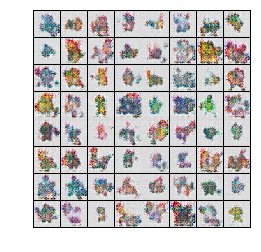

epoch 63
generator loss: 2.81, dis loss real: 0.65, dis loss fake: 0.33


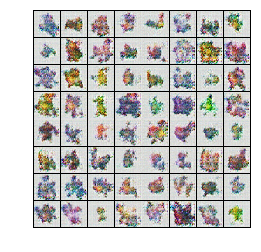

epoch 64
generator loss: 3.23, dis loss real: 0.60, dis loss fake: 0.35


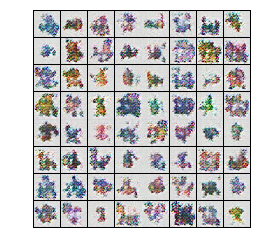

epoch 65
generator loss: 3.25, dis loss real: 0.58, dis loss fake: 0.29


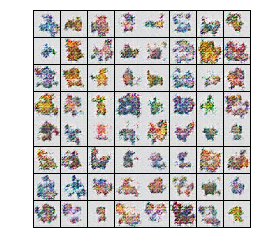

epoch 66
generator loss: 3.41, dis loss real: 0.67, dis loss fake: 0.38


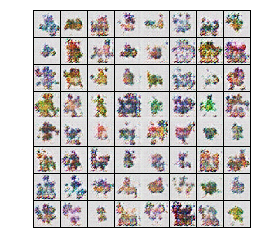

epoch 67
generator loss: 2.84, dis loss real: 0.52, dis loss fake: 0.27


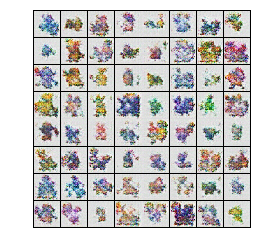

epoch 68
generator loss: 3.31, dis loss real: 0.93, dis loss fake: 0.31


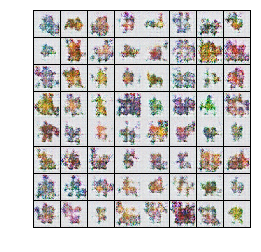

epoch 69
generator loss: 3.35, dis loss real: 0.64, dis loss fake: 0.51


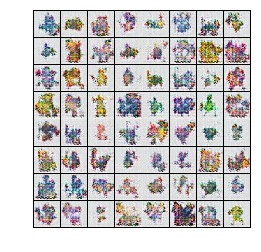

epoch 70
generator loss: 2.71, dis loss real: 0.53, dis loss fake: 0.27


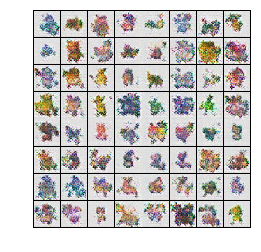

epoch 71
generator loss: 2.97, dis loss real: 0.56, dis loss fake: 0.29


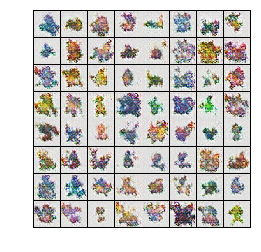

epoch 72
generator loss: 3.04, dis loss real: 0.53, dis loss fake: 0.27


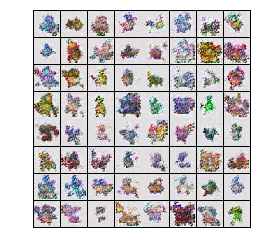

epoch 73
generator loss: 3.19, dis loss real: 0.53, dis loss fake: 0.29


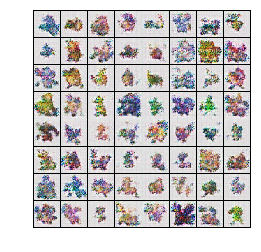

epoch 74
generator loss: 3.19, dis loss real: 0.66, dis loss fake: 0.29


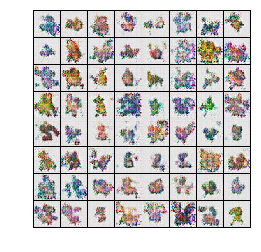

epoch 75
generator loss: 3.11, dis loss real: 0.54, dis loss fake: 0.30


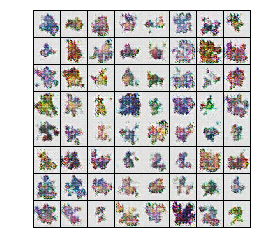

epoch 76
generator loss: 3.43, dis loss real: 0.56, dis loss fake: 0.31


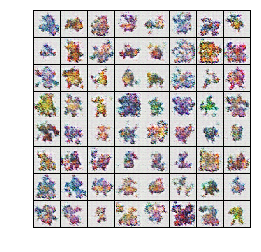

epoch 77
generator loss: 3.18, dis loss real: 0.53, dis loss fake: 0.23


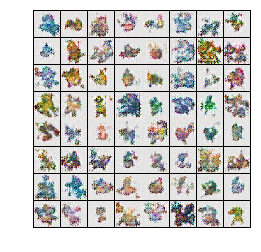

epoch 78
generator loss: 3.65, dis loss real: 0.80, dis loss fake: 0.45


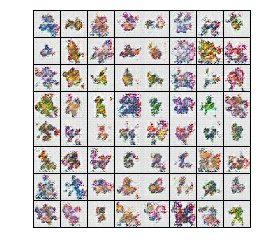

epoch 79
generator loss: 3.07, dis loss real: 0.54, dis loss fake: 0.26


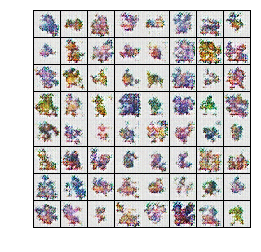

epoch 80
generator loss: 3.26, dis loss real: 0.48, dis loss fake: 0.26


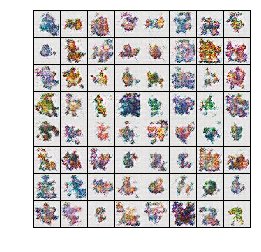

epoch 81
generator loss: 3.20, dis loss real: 0.57, dis loss fake: 0.22


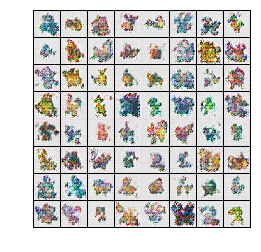

epoch 82
generator loss: 3.43, dis loss real: 0.48, dis loss fake: 0.30


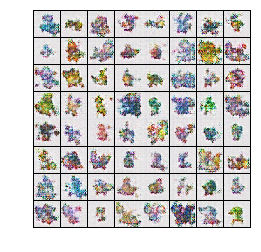

epoch 83
generator loss: 3.27, dis loss real: 0.58, dis loss fake: 0.28


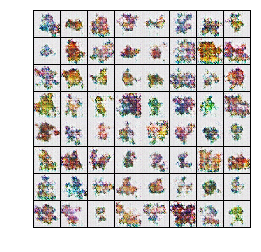

epoch 84
generator loss: 3.44, dis loss real: 0.47, dis loss fake: 0.24


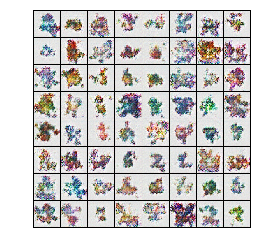

epoch 85
generator loss: 3.36, dis loss real: 0.58, dis loss fake: 0.25


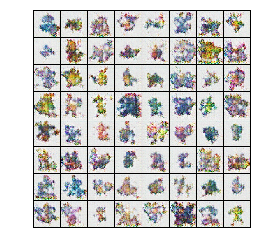

epoch 86
generator loss: 3.13, dis loss real: 0.48, dis loss fake: 0.21


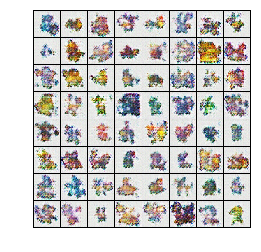

epoch 87
generator loss: 3.67, dis loss real: 0.50, dis loss fake: 0.22


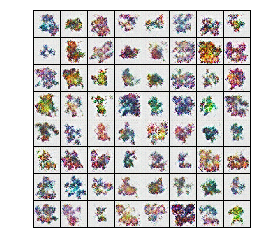

epoch 88
generator loss: 3.47, dis loss real: 0.50, dis loss fake: 0.22


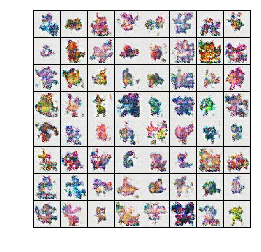

epoch 89
generator loss: 3.42, dis loss real: 0.55, dis loss fake: 0.24


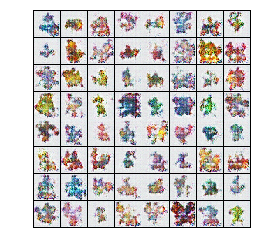

epoch 90
generator loss: 3.23, dis loss real: 0.43, dis loss fake: 0.17


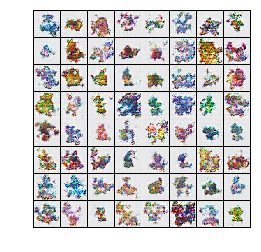

epoch 91
generator loss: 3.70, dis loss real: 0.71, dis loss fake: 0.34


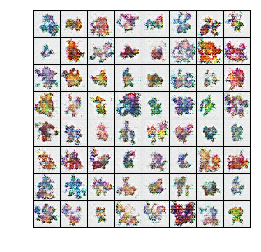

epoch 92
generator loss: 3.35, dis loss real: 0.57, dis loss fake: 0.27


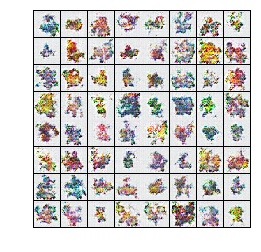

epoch 93
generator loss: 3.50, dis loss real: 0.47, dis loss fake: 0.25


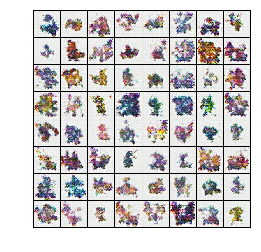

epoch 94
generator loss: 3.34, dis loss real: 0.45, dis loss fake: 0.16


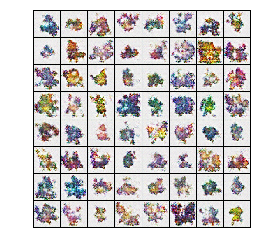

epoch 95
generator loss: 3.48, dis loss real: 0.51, dis loss fake: 0.18


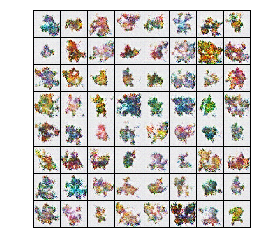

epoch 96
generator loss: 3.64, dis loss real: 0.47, dis loss fake: 0.23


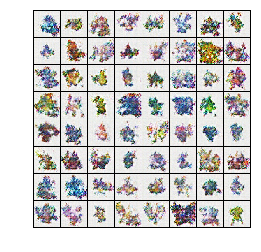

epoch 97
generator loss: 3.58, dis loss real: 0.45, dis loss fake: 0.17


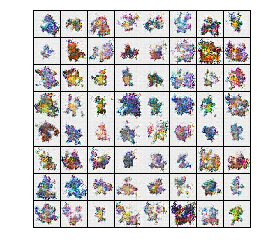

epoch 98
generator loss: 3.87, dis loss real: 0.52, dis loss fake: 0.22


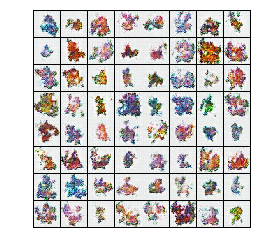

epoch 99
generator loss: 3.45, dis loss real: 0.47, dis loss fake: 0.18


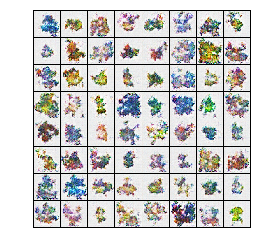

epoch 100
generator loss: 3.75, dis loss real: 0.58, dis loss fake: 0.20


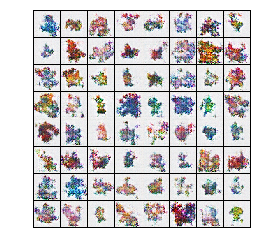

epoch 101
generator loss: 3.66, dis loss real: 0.55, dis loss fake: 0.28


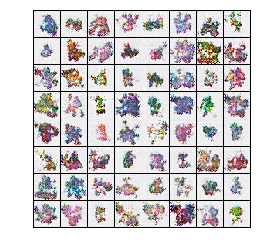

epoch 102
generator loss: 3.66, dis loss real: 0.50, dis loss fake: 0.22


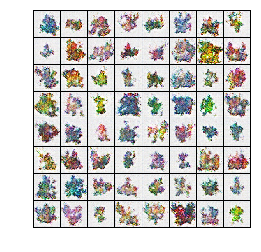

epoch 103
generator loss: 3.73, dis loss real: 0.42, dis loss fake: 0.14


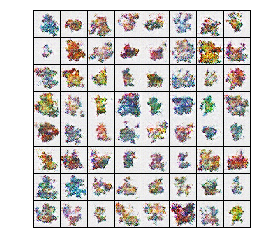

epoch 104
generator loss: 3.98, dis loss real: 0.41, dis loss fake: 0.16


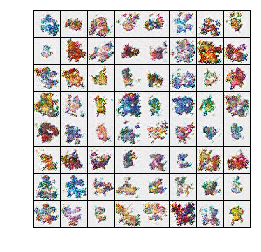

epoch 105
generator loss: 3.51, dis loss real: 0.43, dis loss fake: 0.12


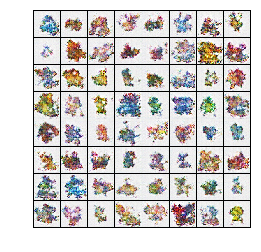

epoch 106
generator loss: 3.62, dis loss real: 0.46, dis loss fake: 0.16


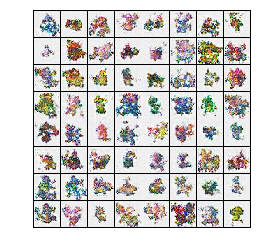

epoch 107
generator loss: 3.90, dis loss real: 0.54, dis loss fake: 0.20


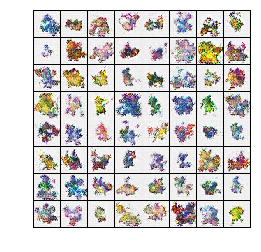

epoch 108
generator loss: 3.77, dis loss real: 0.44, dis loss fake: 0.17


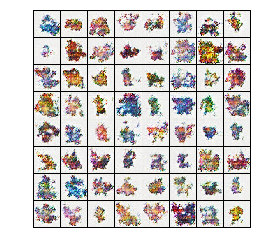

epoch 109
generator loss: 3.83, dis loss real: 0.41, dis loss fake: 0.13


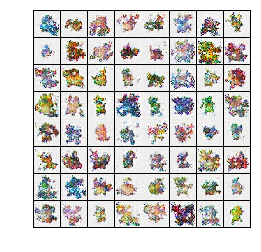

epoch 110
generator loss: 3.68, dis loss real: 0.44, dis loss fake: 0.13


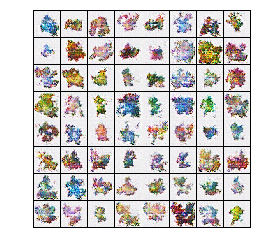

epoch 111
generator loss: 3.76, dis loss real: 0.41, dis loss fake: 0.12


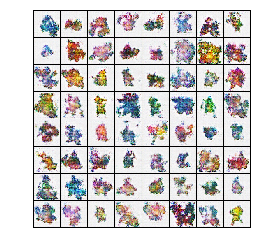

epoch 112
generator loss: 3.78, dis loss real: 0.39, dis loss fake: 0.11


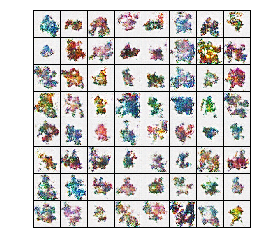

epoch 113
generator loss: 4.51, dis loss real: 0.80, dis loss fake: 0.28


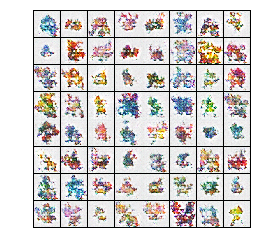

epoch 114
generator loss: 3.72, dis loss real: 0.60, dis loss fake: 0.29


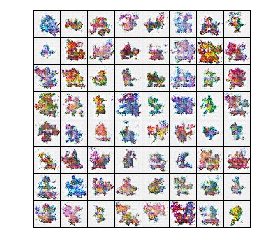

epoch 115
generator loss: 3.55, dis loss real: 0.44, dis loss fake: 0.14


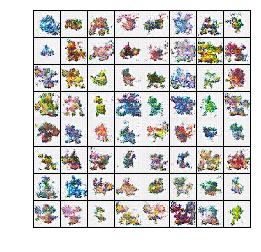

epoch 116
generator loss: 3.71, dis loss real: 0.39, dis loss fake: 0.13


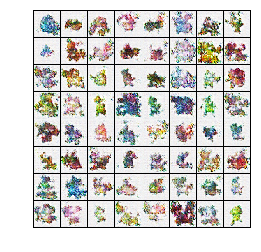

epoch 117
generator loss: 3.66, dis loss real: 0.38, dis loss fake: 0.09


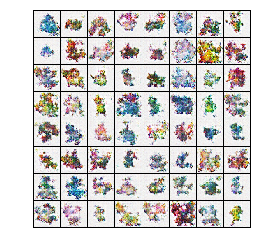

epoch 118
generator loss: 3.96, dis loss real: 0.39, dis loss fake: 0.10


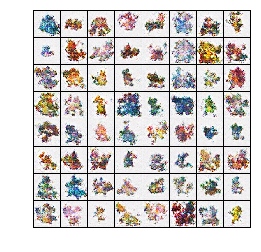

epoch 119
generator loss: 4.05, dis loss real: 0.47, dis loss fake: 0.14


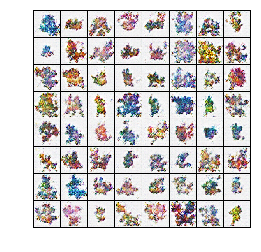

epoch 120
generator loss: 3.96, dis loss real: 0.39, dis loss fake: 0.11


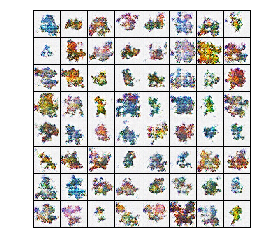

epoch 121
generator loss: 3.96, dis loss real: 0.42, dis loss fake: 0.10


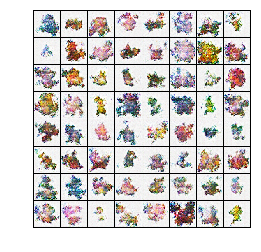

epoch 122
generator loss: 3.96, dis loss real: 0.40, dis loss fake: 0.11


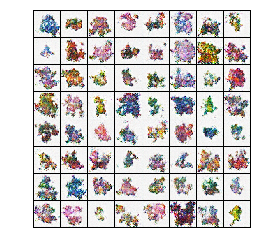

epoch 123
generator loss: 4.61, dis loss real: 0.62, dis loss fake: 0.25


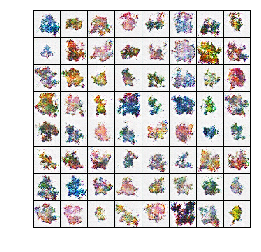

epoch 124
generator loss: 3.98, dis loss real: 0.62, dis loss fake: 0.19


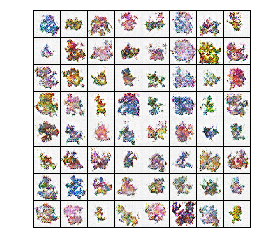

In [11]:
generator_losses = []
discriminator_losses = []
for epoch in range(n_epochs):
    gen_loss_epoch = 0
    dis_loss_epoch_fake = 0
    dis_loss_epoch_real = 0
    batches_processed = 0
    for i, image_batch in enumerate(data_loader):
        batches_processed += 1
        image_batch = image_batch[0]
        batch_size = image_batch.shape[0]
        # --- train discriminator ---
        # clear gradients
        discriminator.zero_grad()
        
        # train on real images
        real_images = to_variable(image_batch)
        real_outputs = discriminator(real_images)
        real_loss = loss_func(real_outputs, to_variable(torch.ones(real_outputs.data.shape))*label_smooth)
        real_loss.backward()
        dis_loss_epoch_real += torch.mean(real_loss.data)
        
        # train on fake images
        noise = to_variable(torch.randn(batch_size, noise_dim, 1, 1))
        fake_images = generator(noise)
        fake_outputs = discriminator(fake_images)
        fake_loss = loss_func(fake_outputs, to_variable(torch.zeros(fake_outputs.data.shape)))
        fake_loss.backward()
        dis_loss_epoch_fake += torch.mean(fake_loss.data)
        
        # update discriminator params
        d_optimizer.step()
        
        # --- train generator ---
        generator.zero_grad()
        
        noise = to_variable(torch.randn(batch_size, noise_dim, 1, 1))
        fake_images = generator(noise)
        dis_outputs = discriminator(fake_images)
        gen_loss = loss_func(dis_outputs, to_variable(torch.ones(dis_outputs.data.shape)))
        gen_loss.backward()
        gen_loss_epoch += torch.mean(gen_loss.data)
        
        # update generator params
        g_optimizer.step()
        
    discriminator_losses.append([dis_loss_epoch_real/batches_processed, dis_loss_epoch_fake/batches_processed])
    generator_losses.append(gen_loss_epoch/batches_processed)
        
    print('epoch {}'.format(epoch))
    print('generator loss: {:0.2f}, dis loss real: {:0.2f}, dis loss fake: {:0.2f}'.format(generator_losses[-1], discriminator_losses[-1][0], discriminator_losses[-1][1]))   
    
    plt.figure()
    fixed_imgs = generator(fixed_noise)
    result = denorm(fixed_imgs.cpu().data)
    result = make_grid(result)
    result = transforms.Compose([transforms.ToPILImage()])(result)
    plt.imshow(result)
    plt.axis('off')
    plt.show()
    
    # save this epoch's model.
    torch.save(generator.state_dict(), os.path.join(pokemon_models, 'generator_ep%d' % epoch))
    torch.save(discriminator.state_dict(), os.path.join(pokemon_models, 'discriminator_ep%d' % epoch))

In [ ]:
plt.figure(figsize=(20,15))
plt.plot(generator_losses, label='generator_loss')
plt.plot(np.array(discriminator_losses)[:,0], label='discriminator_real')
plt.plot(np.array(discriminator_losses)[:,1], label='discriminator_fake')
plt.title('generator loss and discriminator loss')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(loc='upper right')
plt.show()

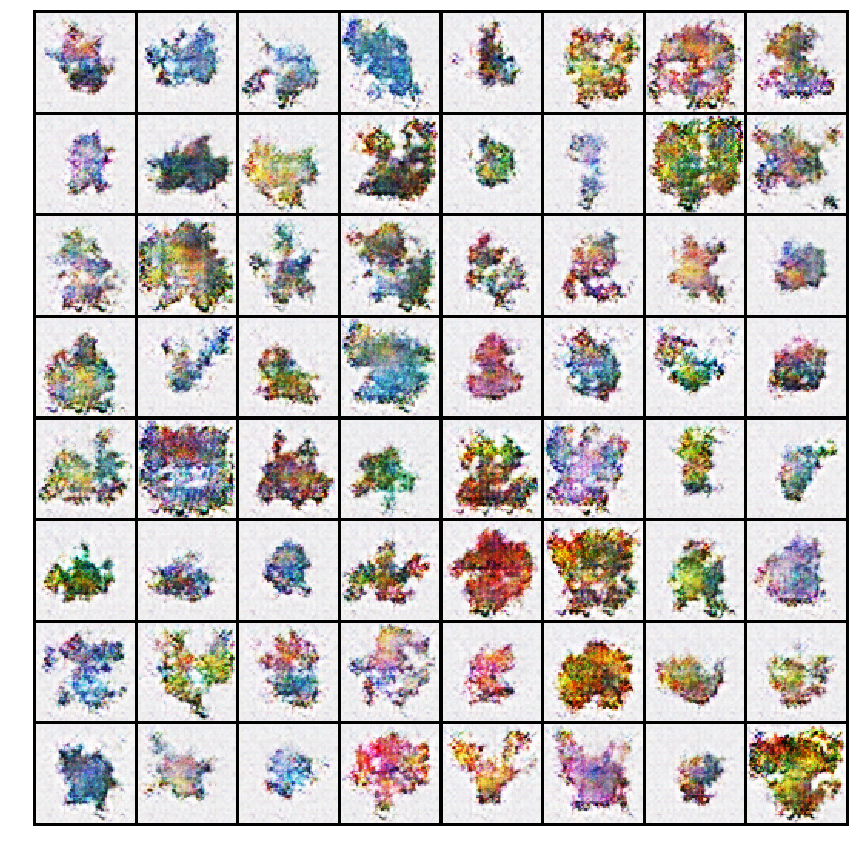

In [12]:
load_model = os.path.join(pokemon_models, 'generator_ep%d' % 110)
generator_final = Generator()
generator_final.load_state_dict(torch.load(load_model))
generator_final.cuda()
fixed_imgs = generator_final(fixed_noise)
result = denorm(fixed_imgs.cpu().data)
result = make_grid(result)
result = transforms.Compose([transforms.ToPILImage()])(result)
plt.figure(figsize=(20,15))
plt.imshow(result)
plt.axis('off')
_ = plt.show()         

This thing starts to overfit heavily after 300 epochs. train for 125 epochs.

In [7]:
!python /scratch/yns207/examples/dcgan/main.py --dataset 'folder' --dataroot $image_path --niter 200 --cuda --outf $pokemon_models 

Namespace(batchSize=64, beta1=0.5, cuda=True, dataroot='/scratch/yns207/imgs/pokemon', dataset='folder', imageSize=64, lr=0.0002, manualSeed=None, ndf=64, netD='', netG='', ngf=64, ngpu=1, niter=200, nz=100, outf='/scratch/yns207/pokemon_models', workers=2)
Random Seed:  5465
_netG (
  (main): Sequential (
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True)
    (2): ReLU (inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True)
    (5): ReLU (inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True)
    (8): ReLU (inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, af

[8/200][5/9] Loss_D: 0.0921 Loss_G: 4.9159 D(x): 0.9344 D(G(z)): 0.0130 / 0.0194
[8/200][6/9] Loss_D: 2.2223 Loss_G: 14.0152 D(x): 0.9750 D(G(z)): 0.7681 / 0.0000
[8/200][7/9] Loss_D: 0.7380 Loss_G: 11.0507 D(x): 0.5697 D(G(z)): 0.0008 / 0.0000
[8/200][8/9] Loss_D: 0.2471 Loss_G: 4.9490 D(x): 0.8431 D(G(z)): 0.0371 / 0.0201
[9/200][0/9] Loss_D: 1.7549 Loss_G: 14.1619 D(x): 0.9415 D(G(z)): 0.7439 / 0.0000
[9/200][1/9] Loss_D: 4.4863 Loss_G: 5.4567 D(x): 0.0309 D(G(z)): 0.0002 / 0.0096
[9/200][2/9] Loss_D: 0.6102 Loss_G: 4.7976 D(x): 0.9205 D(G(z)): 0.3441 / 0.0218
[9/200][3/9] Loss_D: 1.2644 Loss_G: 11.6983 D(x): 0.9230 D(G(z)): 0.6079 / 0.0001
[9/200][4/9] Loss_D: 2.0067 Loss_G: 4.4545 D(x): 0.2386 D(G(z)): 0.0093 / 0.0413
[9/200][5/9] Loss_D: 1.6472 Loss_G: 7.2306 D(x): 0.8310 D(G(z)): 0.6471 / 0.0032
[9/200][6/9] Loss_D: 0.7976 Loss_G: 4.7789 D(x): 0.5815 D(G(z)): 0.0625 / 0.0265
[9/200][7/9] Loss_D: 0.5498 Loss_G: 5.8959 D(x): 0.9142 D(G(z)): 0.3068 / 0.0074
[9/200][8/9] Loss_D: 0.7

[19/200][6/9] Loss_D: 0.2308 Loss_G: 5.9325 D(x): 0.9700 D(G(z)): 0.1738 / 0.0035
[19/200][7/9] Loss_D: 0.1462 Loss_G: 5.4051 D(x): 0.9027 D(G(z)): 0.0297 / 0.0058
[19/200][8/9] Loss_D: 0.1513 Loss_G: 4.2376 D(x): 0.9030 D(G(z)): 0.0415 / 0.0189
[20/200][0/9] Loss_D: 0.3097 Loss_G: 6.5189 D(x): 0.9339 D(G(z)): 0.2028 / 0.0018
[20/200][1/9] Loss_D: 0.3173 Loss_G: 3.6653 D(x): 0.7646 D(G(z)): 0.0150 / 0.0358
[20/200][2/9] Loss_D: 0.2911 Loss_G: 6.0724 D(x): 0.9610 D(G(z)): 0.2113 / 0.0029
[20/200][3/9] Loss_D: 0.1134 Loss_G: 6.0026 D(x): 0.9152 D(G(z)): 0.0213 / 0.0033
[20/200][4/9] Loss_D: 0.1655 Loss_G: 3.8959 D(x): 0.8805 D(G(z)): 0.0251 / 0.0253
[20/200][5/9] Loss_D: 0.2367 Loss_G: 5.7942 D(x): 0.9650 D(G(z)): 0.1707 / 0.0037
[20/200][6/9] Loss_D: 0.2102 Loss_G: 4.4715 D(x): 0.8521 D(G(z)): 0.0291 / 0.0146
[20/200][7/9] Loss_D: 0.1231 Loss_G: 4.4227 D(x): 0.9496 D(G(z)): 0.0654 / 0.0153
[20/200][8/9] Loss_D: 0.2058 Loss_G: 5.3099 D(x): 0.9301 D(G(z)): 0.1200 / 0.0064
[21/200][0/9] Lo

[30/200][7/9] Loss_D: 0.1693 Loss_G: 2.7573 D(x): 0.9543 D(G(z)): 0.1033 / 0.1009
[30/200][8/9] Loss_D: 0.7140 Loss_G: 6.8284 D(x): 0.9797 D(G(z)): 0.4436 / 0.0018
[31/200][0/9] Loss_D: 0.3193 Loss_G: 5.3901 D(x): 0.7637 D(G(z)): 0.0173 / 0.0080
[31/200][1/9] Loss_D: 0.2606 Loss_G: 3.1391 D(x): 0.8260 D(G(z)): 0.0460 / 0.0705
[31/200][2/9] Loss_D: 0.4046 Loss_G: 4.9507 D(x): 0.9532 D(G(z)): 0.2666 / 0.0137
[31/200][3/9] Loss_D: 0.2202 Loss_G: 5.0327 D(x): 0.8860 D(G(z)): 0.0800 / 0.0124
[31/200][4/9] Loss_D: 0.1799 Loss_G: 4.3020 D(x): 0.9066 D(G(z)): 0.0645 / 0.0229
[31/200][5/9] Loss_D: 0.2143 Loss_G: 4.2290 D(x): 0.9219 D(G(z)): 0.1165 / 0.0228
[31/200][6/9] Loss_D: 0.2896 Loss_G: 3.8135 D(x): 0.8570 D(G(z)): 0.1108 / 0.0310
[31/200][7/9] Loss_D: 0.3383 Loss_G: 4.5521 D(x): 0.8740 D(G(z)): 0.1736 / 0.0146
[31/200][8/9] Loss_D: 0.1975 Loss_G: 4.0546 D(x): 0.8577 D(G(z)): 0.0336 / 0.0263
[32/200][0/9] Loss_D: 0.2192 Loss_G: 4.5823 D(x): 0.9586 D(G(z)): 0.1545 / 0.0148
[32/200][1/9] Lo

[41/200][8/9] Loss_D: 0.2346 Loss_G: 4.6695 D(x): 0.9001 D(G(z)): 0.1077 / 0.0147
[42/200][0/9] Loss_D: 0.3225 Loss_G: 3.0421 D(x): 0.8036 D(G(z)): 0.0831 / 0.0629
[42/200][1/9] Loss_D: 0.2574 Loss_G: 4.3910 D(x): 0.9405 D(G(z)): 0.1675 / 0.0166
[42/200][2/9] Loss_D: 0.2821 Loss_G: 3.4366 D(x): 0.8263 D(G(z)): 0.0701 / 0.0409
[42/200][3/9] Loss_D: 0.4130 Loss_G: 5.6401 D(x): 0.9159 D(G(z)): 0.2549 / 0.0048
[42/200][4/9] Loss_D: 0.3600 Loss_G: 2.8629 D(x): 0.7397 D(G(z)): 0.0333 / 0.0857
[42/200][5/9] Loss_D: 0.3521 Loss_G: 4.7626 D(x): 0.9400 D(G(z)): 0.2311 / 0.0121
[42/200][6/9] Loss_D: 0.2902 Loss_G: 3.6725 D(x): 0.8262 D(G(z)): 0.0809 / 0.0350
[42/200][7/9] Loss_D: 0.2798 Loss_G: 5.2294 D(x): 0.9457 D(G(z)): 0.1874 / 0.0079
[42/200][8/9] Loss_D: 0.5090 Loss_G: 1.2810 D(x): 0.6509 D(G(z)): 0.0248 / 0.3345
[43/200][0/9] Loss_D: 1.1380 Loss_G: 9.0738 D(x): 0.9835 D(G(z)): 0.6284 / 0.0002
[43/200][1/9] Loss_D: 1.6629 Loss_G: 2.5359 D(x): 0.2476 D(G(z)): 0.0011 / 0.1009
[43/200][2/9] Lo

[53/200][0/9] Loss_D: 0.2729 Loss_G: 3.9937 D(x): 0.9082 D(G(z)): 0.1356 / 0.0277
[53/200][1/9] Loss_D: 0.1618 Loss_G: 4.0138 D(x): 0.9216 D(G(z)): 0.0705 / 0.0249
[53/200][2/9] Loss_D: 0.2423 Loss_G: 3.3992 D(x): 0.8843 D(G(z)): 0.0990 / 0.0434
[53/200][3/9] Loss_D: 0.3901 Loss_G: 4.1200 D(x): 0.8760 D(G(z)): 0.1981 / 0.0242
[53/200][4/9] Loss_D: 0.4701 Loss_G: 2.2451 D(x): 0.7092 D(G(z)): 0.0813 / 0.1272
[53/200][5/9] Loss_D: 0.5740 Loss_G: 6.7219 D(x): 0.9392 D(G(z)): 0.3768 / 0.0019
[53/200][6/9] Loss_D: 0.5785 Loss_G: 3.0357 D(x): 0.6175 D(G(z)): 0.0077 / 0.0614
[53/200][7/9] Loss_D: 0.3350 Loss_G: 4.2183 D(x): 0.9484 D(G(z)): 0.2333 / 0.0174
[53/200][8/9] Loss_D: 0.3244 Loss_G: 5.2295 D(x): 0.8973 D(G(z)): 0.1772 / 0.0076
[54/200][0/9] Loss_D: 0.3017 Loss_G: 3.7475 D(x): 0.7794 D(G(z)): 0.0299 / 0.0341
[54/200][1/9] Loss_D: 0.2556 Loss_G: 3.6922 D(x): 0.9167 D(G(z)): 0.1465 / 0.0328
[54/200][2/9] Loss_D: 0.3716 Loss_G: 5.3186 D(x): 0.9114 D(G(z)): 0.2305 / 0.0067
[54/200][3/9] Lo

[64/200][1/9] Loss_D: 3.0566 Loss_G: 3.2023 D(x): 0.0985 D(G(z)): 0.0010 / 0.0885
[64/200][2/9] Loss_D: 0.3220 Loss_G: 4.1916 D(x): 0.9873 D(G(z)): 0.2365 / 0.0250
[64/200][3/9] Loss_D: 0.5175 Loss_G: 7.2602 D(x): 0.9525 D(G(z)): 0.3168 / 0.0015
[64/200][4/9] Loss_D: 2.5807 Loss_G: 0.2972 D(x): 0.1954 D(G(z)): 0.0147 / 0.7726
[64/200][5/9] Loss_D: 2.5310 Loss_G: 8.6391 D(x): 0.9988 D(G(z)): 0.8815 / 0.0007
[64/200][6/9] Loss_D: 1.7047 Loss_G: 4.3287 D(x): 0.2641 D(G(z)): 0.0030 / 0.0314
[64/200][7/9] Loss_D: 0.3263 Loss_G: 2.6467 D(x): 0.9542 D(G(z)): 0.1970 / 0.1303
[64/200][8/9] Loss_D: 0.8874 Loss_G: 6.3145 D(x): 0.9936 D(G(z)): 0.4934 / 0.0037
[65/200][0/9] Loss_D: 0.3727 Loss_G: 4.5070 D(x): 0.7525 D(G(z)): 0.0325 / 0.0200
[65/200][1/9] Loss_D: 0.4399 Loss_G: 2.7241 D(x): 0.8268 D(G(z)): 0.1751 / 0.0974
[65/200][2/9] Loss_D: 0.8813 Loss_G: 6.1723 D(x): 0.8942 D(G(z)): 0.4773 / 0.0030
[65/200][3/9] Loss_D: 1.2186 Loss_G: 2.2152 D(x): 0.4173 D(G(z)): 0.0189 / 0.1422
[65/200][4/9] Lo

[75/200][2/9] Loss_D: 0.1669 Loss_G: 3.1462 D(x): 0.9065 D(G(z)): 0.0611 / 0.0563
[75/200][3/9] Loss_D: 0.2555 Loss_G: 4.5186 D(x): 0.9575 D(G(z)): 0.1778 / 0.0141
[75/200][4/9] Loss_D: 0.2707 Loss_G: 3.4424 D(x): 0.8362 D(G(z)): 0.0730 / 0.0489
[75/200][5/9] Loss_D: 0.2718 Loss_G: 3.8651 D(x): 0.8982 D(G(z)): 0.1416 / 0.0281
[75/200][6/9] Loss_D: 0.3037 Loss_G: 3.3827 D(x): 0.8514 D(G(z)): 0.1160 / 0.0436
[75/200][7/9] Loss_D: 0.3002 Loss_G: 3.6325 D(x): 0.8607 D(G(z)): 0.1203 / 0.0420
[75/200][8/9] Loss_D: 0.3184 Loss_G: 3.0778 D(x): 0.8447 D(G(z)): 0.1239 / 0.0575
[76/200][0/9] Loss_D: 0.2557 Loss_G: 5.1084 D(x): 0.9521 D(G(z)): 0.1793 / 0.0077
[76/200][1/9] Loss_D: 0.3933 Loss_G: 1.6536 D(x): 0.7097 D(G(z)): 0.0274 / 0.2471
[76/200][2/9] Loss_D: 0.7917 Loss_G: 8.9001 D(x): 0.9788 D(G(z)): 0.4966 / 0.0003
[76/200][3/9] Loss_D: 1.5461 Loss_G: 1.3199 D(x): 0.2746 D(G(z)): 0.0016 / 0.3267
[76/200][4/9] Loss_D: 1.1624 Loss_G: 9.3717 D(x): 0.9929 D(G(z)): 0.6317 / 0.0002
[76/200][5/9] Lo

[86/200][3/9] Loss_D: 0.4528 Loss_G: 6.1063 D(x): 0.9541 D(G(z)): 0.3026 / 0.0032
[86/200][4/9] Loss_D: 0.4339 Loss_G: 3.1430 D(x): 0.6928 D(G(z)): 0.0244 / 0.0558
[86/200][5/9] Loss_D: 0.3115 Loss_G: 4.6109 D(x): 0.9485 D(G(z)): 0.2102 / 0.0132
[86/200][6/9] Loss_D: 0.2197 Loss_G: 4.2775 D(x): 0.8811 D(G(z)): 0.0833 / 0.0184
[86/200][7/9] Loss_D: 0.3354 Loss_G: 3.8222 D(x): 0.8436 D(G(z)): 0.1366 / 0.0305
[86/200][8/9] Loss_D: 0.3243 Loss_G: 4.1898 D(x): 0.8703 D(G(z)): 0.1568 / 0.0189
[87/200][0/9] Loss_D: 0.2934 Loss_G: 3.7576 D(x): 0.8562 D(G(z)): 0.1181 / 0.0300
[87/200][1/9] Loss_D: 0.2685 Loss_G: 4.4121 D(x): 0.8985 D(G(z)): 0.1426 / 0.0154
[87/200][2/9] Loss_D: 0.3888 Loss_G: 2.4397 D(x): 0.7715 D(G(z)): 0.0963 / 0.1136
[87/200][3/9] Loss_D: 0.5649 Loss_G: 8.1980 D(x): 0.9580 D(G(z)): 0.3680 / 0.0005
[87/200][4/9] Loss_D: 1.2767 Loss_G: 1.2109 D(x): 0.3337 D(G(z)): 0.0036 / 0.3708
[87/200][5/9] Loss_D: 1.2119 Loss_G: 8.6657 D(x): 0.9869 D(G(z)): 0.6499 / 0.0002
[87/200][6/9] Lo

[97/200][4/9] Loss_D: 0.2930 Loss_G: 2.9921 D(x): 0.8377 D(G(z)): 0.0804 / 0.0908
[97/200][5/9] Loss_D: 0.7746 Loss_G: 6.6429 D(x): 0.9615 D(G(z)): 0.4492 / 0.0022
[97/200][6/9] Loss_D: 1.0687 Loss_G: 1.7391 D(x): 0.4290 D(G(z)): 0.0298 / 0.2532
[97/200][7/9] Loss_D: 1.7819 Loss_G: 10.0291 D(x): 0.9835 D(G(z)): 0.7816 / 0.0001
[97/200][8/9] Loss_D: 1.4740 Loss_G: 5.6690 D(x): 0.3230 D(G(z)): 0.0020 / 0.0105
[98/200][0/9] Loss_D: 0.2060 Loss_G: 2.9420 D(x): 0.9503 D(G(z)): 0.1256 / 0.0875
[98/200][1/9] Loss_D: 0.6200 Loss_G: 6.5852 D(x): 0.9614 D(G(z)): 0.3854 / 0.0023
[98/200][2/9] Loss_D: 0.4378 Loss_G: 4.5991 D(x): 0.7436 D(G(z)): 0.0652 / 0.0168
[98/200][3/9] Loss_D: 0.3027 Loss_G: 4.0630 D(x): 0.8893 D(G(z)): 0.1350 / 0.0294
[98/200][4/9] Loss_D: 0.3170 Loss_G: 4.2306 D(x): 0.8906 D(G(z)): 0.1545 / 0.0213
[98/200][5/9] Loss_D: 0.4250 Loss_G: 4.5023 D(x): 0.8552 D(G(z)): 0.1882 / 0.0152
[98/200][6/9] Loss_D: 0.3862 Loss_G: 3.2803 D(x): 0.7813 D(G(z)): 0.0956 / 0.0511
[98/200][7/9] L

[108/200][4/9] Loss_D: 0.3037 Loss_G: 4.9923 D(x): 0.9364 D(G(z)): 0.1994 / 0.0083
[108/200][5/9] Loss_D: 0.2503 Loss_G: 3.1904 D(x): 0.8160 D(G(z)): 0.0289 / 0.0557
[108/200][6/9] Loss_D: 0.2477 Loss_G: 4.5282 D(x): 0.9513 D(G(z)): 0.1689 / 0.0137
[108/200][7/9] Loss_D: 0.1912 Loss_G: 3.9124 D(x): 0.8831 D(G(z)): 0.0574 / 0.0276
[108/200][8/9] Loss_D: 0.2635 Loss_G: 3.2554 D(x): 0.8744 D(G(z)): 0.0969 / 0.0547
[109/200][0/9] Loss_D: 0.2082 Loss_G: 4.4375 D(x): 0.9448 D(G(z)): 0.1324 / 0.0167
[109/200][1/9] Loss_D: 0.1830 Loss_G: 4.1107 D(x): 0.9007 D(G(z)): 0.0712 / 0.0209
[109/200][2/9] Loss_D: 0.1617 Loss_G: 3.3355 D(x): 0.8903 D(G(z)): 0.0405 / 0.0485
[109/200][3/9] Loss_D: 0.2291 Loss_G: 4.4478 D(x): 0.9514 D(G(z)): 0.1565 / 0.0146
[109/200][4/9] Loss_D: 0.1749 Loss_G: 4.4149 D(x): 0.9095 D(G(z)): 0.0694 / 0.0180
[109/200][5/9] Loss_D: 0.2402 Loss_G: 2.5195 D(x): 0.8391 D(G(z)): 0.0552 / 0.1185
[109/200][6/9] Loss_D: 0.3123 Loss_G: 5.3047 D(x): 0.9536 D(G(z)): 0.2172 / 0.0063
[109

[119/200][4/9] Loss_D: 0.2165 Loss_G: 4.8072 D(x): 0.9624 D(G(z)): 0.1519 / 0.0112
[119/200][5/9] Loss_D: 0.1652 Loss_G: 3.9323 D(x): 0.8827 D(G(z)): 0.0350 / 0.0273
[119/200][6/9] Loss_D: 0.1458 Loss_G: 4.0205 D(x): 0.9459 D(G(z)): 0.0818 / 0.0238
[119/200][7/9] Loss_D: 0.1975 Loss_G: 3.8648 D(x): 0.9042 D(G(z)): 0.0876 / 0.0272
[119/200][8/9] Loss_D: 0.1739 Loss_G: 3.8194 D(x): 0.9077 D(G(z)): 0.0689 / 0.0301
[120/200][0/9] Loss_D: 0.1717 Loss_G: 4.5551 D(x): 0.9489 D(G(z)): 0.1075 / 0.0143
[120/200][1/9] Loss_D: 0.1736 Loss_G: 3.2615 D(x): 0.8836 D(G(z)): 0.0448 / 0.0502
[120/200][2/9] Loss_D: 0.2307 Loss_G: 4.8345 D(x): 0.9481 D(G(z)): 0.1545 / 0.0104
[120/200][3/9] Loss_D: 0.1724 Loss_G: 3.7851 D(x): 0.8784 D(G(z)): 0.0373 / 0.0310
[120/200][4/9] Loss_D: 0.1218 Loss_G: 4.1752 D(x): 0.9556 D(G(z)): 0.0707 / 0.0219
[120/200][5/9] Loss_D: 0.2143 Loss_G: 3.8621 D(x): 0.9013 D(G(z)): 0.0961 / 0.0283
[120/200][6/9] Loss_D: 0.1582 Loss_G: 3.6611 D(x): 0.9177 D(G(z)): 0.0639 / 0.0321
[120

[130/200][4/9] Loss_D: 0.2495 Loss_G: 2.9187 D(x): 0.8141 D(G(z)): 0.0310 / 0.0823
[130/200][5/9] Loss_D: 0.2436 Loss_G: 5.0747 D(x): 0.9630 D(G(z)): 0.1766 / 0.0081
[130/200][6/9] Loss_D: 0.1595 Loss_G: 4.1080 D(x): 0.8961 D(G(z)): 0.0448 / 0.0227
[130/200][7/9] Loss_D: 0.1736 Loss_G: 3.4318 D(x): 0.9103 D(G(z)): 0.0711 / 0.0414
[130/200][8/9] Loss_D: 0.1962 Loss_G: 5.0593 D(x): 0.9507 D(G(z)): 0.1223 / 0.0098
[131/200][0/9] Loss_D: 0.1355 Loss_G: 4.1749 D(x): 0.9106 D(G(z)): 0.0383 / 0.0244
[131/200][1/9] Loss_D: 0.1631 Loss_G: 3.9244 D(x): 0.9334 D(G(z)): 0.0855 / 0.0259
[131/200][2/9] Loss_D: 0.1740 Loss_G: 3.5806 D(x): 0.9047 D(G(z)): 0.0676 / 0.0362
[131/200][3/9] Loss_D: 0.2058 Loss_G: 4.3114 D(x): 0.9283 D(G(z)): 0.1167 / 0.0175
[131/200][4/9] Loss_D: 0.1869 Loss_G: 3.6972 D(x): 0.8907 D(G(z)): 0.0642 / 0.0329
[131/200][5/9] Loss_D: 0.1671 Loss_G: 3.8394 D(x): 0.9258 D(G(z)): 0.0823 / 0.0289
[131/200][6/9] Loss_D: 0.1727 Loss_G: 3.7380 D(x): 0.9165 D(G(z)): 0.0770 / 0.0297
[131

[141/200][4/9] Loss_D: 0.1594 Loss_G: 4.0881 D(x): 0.9444 D(G(z)): 0.0934 / 0.0217
[141/200][5/9] Loss_D: 0.1195 Loss_G: 4.1169 D(x): 0.9378 D(G(z)): 0.0520 / 0.0198
[141/200][6/9] Loss_D: 0.1400 Loss_G: 3.6770 D(x): 0.9255 D(G(z)): 0.0582 / 0.0333
[141/200][7/9] Loss_D: 0.1524 Loss_G: 3.8035 D(x): 0.9349 D(G(z)): 0.0787 / 0.0287
[141/200][8/9] Loss_D: 0.1749 Loss_G: 4.0977 D(x): 0.9276 D(G(z)): 0.0920 / 0.0204
[142/200][0/9] Loss_D: 0.1470 Loss_G: 4.0275 D(x): 0.9220 D(G(z)): 0.0610 / 0.0275
[142/200][1/9] Loss_D: 0.1153 Loss_G: 3.9154 D(x): 0.9403 D(G(z)): 0.0507 / 0.0284
[142/200][2/9] Loss_D: 0.1309 Loss_G: 4.0019 D(x): 0.9445 D(G(z)): 0.0694 / 0.0229
[142/200][3/9] Loss_D: 0.2238 Loss_G: 3.2997 D(x): 0.8858 D(G(z)): 0.0864 / 0.0471
[142/200][4/9] Loss_D: 0.2099 Loss_G: 3.2030 D(x): 0.8939 D(G(z)): 0.0847 / 0.0567
[142/200][5/9] Loss_D: 0.1762 Loss_G: 4.5902 D(x): 0.9570 D(G(z)): 0.1186 / 0.0126
[142/200][6/9] Loss_D: 0.1495 Loss_G: 3.7861 D(x): 0.9069 D(G(z)): 0.0469 / 0.0303
[142

[152/200][4/9] Loss_D: 0.2785 Loss_G: 3.8034 D(x): 0.8795 D(G(z)): 0.1272 / 0.0307
[152/200][5/9] Loss_D: 0.3528 Loss_G: 4.3284 D(x): 0.8734 D(G(z)): 0.1735 / 0.0176
[152/200][6/9] Loss_D: 0.4412 Loss_G: 2.3776 D(x): 0.7306 D(G(z)): 0.0822 / 0.1373
[152/200][7/9] Loss_D: 0.6635 Loss_G: 7.1470 D(x): 0.9758 D(G(z)): 0.4264 / 0.0011
[152/200][8/9] Loss_D: 0.8385 Loss_G: 3.1914 D(x): 0.5047 D(G(z)): 0.0086 / 0.1025
[153/200][0/9] Loss_D: 0.3946 Loss_G: 4.6543 D(x): 0.9785 D(G(z)): 0.2661 / 0.0207
[153/200][1/9] Loss_D: 0.1396 Loss_G: 5.5476 D(x): 0.9643 D(G(z)): 0.0897 / 0.0069
[153/200][2/9] Loss_D: 0.1509 Loss_G: 4.9577 D(x): 0.9269 D(G(z)): 0.0665 / 0.0120
[153/200][3/9] Loss_D: 0.1917 Loss_G: 3.7854 D(x): 0.8844 D(G(z)): 0.0542 / 0.0351
[153/200][4/9] Loss_D: 0.3006 Loss_G: 3.8882 D(x): 0.8948 D(G(z)): 0.1523 / 0.0288
[153/200][5/9] Loss_D: 0.3207 Loss_G: 3.6928 D(x): 0.8472 D(G(z)): 0.1240 / 0.0397
[153/200][6/9] Loss_D: 0.2910 Loss_G: 4.2120 D(x): 0.8942 D(G(z)): 0.1482 / 0.0200
[153

[163/200][4/9] Loss_D: 0.1211 Loss_G: 3.8392 D(x): 0.9295 D(G(z)): 0.0438 / 0.0288
[163/200][5/9] Loss_D: 0.1251 Loss_G: 4.1857 D(x): 0.9525 D(G(z)): 0.0712 / 0.0196
[163/200][6/9] Loss_D: 0.0922 Loss_G: 3.9923 D(x): 0.9464 D(G(z)): 0.0354 / 0.0214
[163/200][7/9] Loss_D: 0.1450 Loss_G: 3.3924 D(x): 0.9163 D(G(z)): 0.0533 / 0.0464
[163/200][8/9] Loss_D: 0.1480 Loss_G: 4.7103 D(x): 0.9575 D(G(z)): 0.0961 / 0.0110
[164/200][0/9] Loss_D: 0.1237 Loss_G: 3.7054 D(x): 0.9124 D(G(z)): 0.0292 / 0.0330
[164/200][1/9] Loss_D: 0.0930 Loss_G: 4.2314 D(x): 0.9743 D(G(z)): 0.0629 / 0.0193
[164/200][2/9] Loss_D: 0.0978 Loss_G: 4.9979 D(x): 0.9693 D(G(z)): 0.0616 / 0.0099
[164/200][3/9] Loss_D: 0.1106 Loss_G: 3.6620 D(x): 0.9124 D(G(z)): 0.0151 / 0.0347
[164/200][4/9] Loss_D: 0.1130 Loss_G: 4.2645 D(x): 0.9773 D(G(z)): 0.0834 / 0.0181
[164/200][5/9] Loss_D: 0.1091 Loss_G: 4.4114 D(x): 0.9492 D(G(z)): 0.0529 / 0.0170
[164/200][6/9] Loss_D: 0.0942 Loss_G: 3.8002 D(x): 0.9340 D(G(z)): 0.0246 / 0.0295
[164

[174/200][4/9] Loss_D: 0.1928 Loss_G: 3.5936 D(x): 0.8625 D(G(z)): 0.0356 / 0.0398
[174/200][5/9] Loss_D: 0.1264 Loss_G: 4.2050 D(x): 0.9712 D(G(z)): 0.0888 / 0.0185
[174/200][6/9] Loss_D: 0.1966 Loss_G: 4.3016 D(x): 0.9146 D(G(z)): 0.0932 / 0.0185
[174/200][7/9] Loss_D: 0.1381 Loss_G: 4.0160 D(x): 0.9221 D(G(z)): 0.0527 / 0.0258
[174/200][8/9] Loss_D: 0.1587 Loss_G: 4.4064 D(x): 0.9459 D(G(z)): 0.0881 / 0.0160
[175/200][0/9] Loss_D: 0.1160 Loss_G: 4.3638 D(x): 0.9433 D(G(z)): 0.0538 / 0.0180
[175/200][1/9] Loss_D: 0.1160 Loss_G: 4.2510 D(x): 0.9516 D(G(z)): 0.0626 / 0.0178
[175/200][2/9] Loss_D: 0.2173 Loss_G: 3.7131 D(x): 0.8786 D(G(z)): 0.0744 / 0.0354
[175/200][3/9] Loss_D: 0.1335 Loss_G: 4.0996 D(x): 0.9493 D(G(z)): 0.0748 / 0.0242
[175/200][4/9] Loss_D: 0.1479 Loss_G: 4.7312 D(x): 0.9531 D(G(z)): 0.0883 / 0.0128
[175/200][5/9] Loss_D: 0.2184 Loss_G: 3.2000 D(x): 0.8522 D(G(z)): 0.0486 / 0.0544
[175/200][6/9] Loss_D: 0.2165 Loss_G: 5.1565 D(x): 0.9600 D(G(z)): 0.1519 / 0.0079
[175

[185/200][4/9] Loss_D: 0.1237 Loss_G: 3.5987 D(x): 0.9061 D(G(z)): 0.0223 / 0.0368
[185/200][5/9] Loss_D: 0.0978 Loss_G: 4.3137 D(x): 0.9736 D(G(z)): 0.0666 / 0.0175
[185/200][6/9] Loss_D: 0.0939 Loss_G: 4.3701 D(x): 0.9532 D(G(z)): 0.0436 / 0.0161
[185/200][7/9] Loss_D: 0.1012 Loss_G: 3.6371 D(x): 0.9357 D(G(z)): 0.0328 / 0.0380
[185/200][8/9] Loss_D: 0.0755 Loss_G: 4.6618 D(x): 0.9844 D(G(z)): 0.0565 / 0.0127
[186/200][0/9] Loss_D: 0.0822 Loss_G: 4.2742 D(x): 0.9520 D(G(z)): 0.0312 / 0.0180
[186/200][1/9] Loss_D: 0.0751 Loss_G: 4.2643 D(x): 0.9639 D(G(z)): 0.0366 / 0.0199
[186/200][2/9] Loss_D: 0.0818 Loss_G: 4.0501 D(x): 0.9608 D(G(z)): 0.0401 / 0.0219
[186/200][3/9] Loss_D: 0.0835 Loss_G: 4.3558 D(x): 0.9642 D(G(z)): 0.0444 / 0.0183
[186/200][4/9] Loss_D: 0.0895 Loss_G: 3.9281 D(x): 0.9497 D(G(z)): 0.0361 / 0.0267
[186/200][5/9] Loss_D: 0.0878 Loss_G: 4.0755 D(x): 0.9598 D(G(z)): 0.0447 / 0.0210
[186/200][6/9] Loss_D: 0.1041 Loss_G: 3.7802 D(x): 0.9447 D(G(z)): 0.0445 / 0.0301
[186

[196/200][4/9] Loss_D: 0.1472 Loss_G: 3.5929 D(x): 0.9123 D(G(z)): 0.0496 / 0.0404
[196/200][5/9] Loss_D: 0.1206 Loss_G: 4.6103 D(x): 0.9661 D(G(z)): 0.0789 / 0.0148
[196/200][6/9] Loss_D: 0.0731 Loss_G: 4.7334 D(x): 0.9591 D(G(z)): 0.0296 / 0.0122
[196/200][7/9] Loss_D: 0.0875 Loss_G: 4.0028 D(x): 0.9460 D(G(z)): 0.0303 / 0.0240
[196/200][8/9] Loss_D: 0.1319 Loss_G: 4.4683 D(x): 0.9545 D(G(z)): 0.0755 / 0.0164
[197/200][0/9] Loss_D: 0.0696 Loss_G: 4.5143 D(x): 0.9648 D(G(z)): 0.0328 / 0.0148
[197/200][1/9] Loss_D: 0.0684 Loss_G: 4.3651 D(x): 0.9620 D(G(z)): 0.0287 / 0.0177
[197/200][2/9] Loss_D: 0.0971 Loss_G: 4.3042 D(x): 0.9622 D(G(z)): 0.0537 / 0.0178
[197/200][3/9] Loss_D: 0.0930 Loss_G: 4.1621 D(x): 0.9453 D(G(z)): 0.0350 / 0.0226
[197/200][4/9] Loss_D: 0.0837 Loss_G: 4.4077 D(x): 0.9722 D(G(z)): 0.0526 / 0.0168
[197/200][5/9] Loss_D: 0.1000 Loss_G: 4.2716 D(x): 0.9432 D(G(z)): 0.0386 / 0.0210
[197/200][6/9] Loss_D: 0.0926 Loss_G: 4.2212 D(x): 0.9587 D(G(z)): 0.0477 / 0.0203
[197

step 1 generate a blob

step 2 evaluate the cohesiveness of the blob. (cycle to step 1 until we find a cohesive enough blob)

step 3 clean up colos by getting rid of stuff where it should be white, adding a black outline.

step 4 pick a head.

step 5 add eyes to the head.

step 6 pokemon done

https://docs.opencv.org/3.3.1/d5/d69/tutorial_py_non_local_means.html

https://docs.opencv.org/3.1.0/d4/d13/tutorial_py_filtering.html

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [14]:
load_model = os.path.join(pokemon_models, 'generator_ep%d' % 110)
generator_final = Generator()
generator_final.load_state_dict(torch.load(load_model))
generator_final.cuda()

Generator (
  (main): Sequential (
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True)
    (2): ReLU ()
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True)
    (5): ReLU ()
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True)
    (8): ReLU ()
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True)
    (11): ReLU ()
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh ()
  )
)

In [50]:
fixed_imgs = generator_final(fixed_noise)
result = denorm(fixed_imgs.cpu().data[0])
result_orig = np.transpose(result.numpy())
result_blur = cv2.fastNlMeansDenoisingColored(np.transpose(result.numpy()))
plt.imshow(result_blur)
plt.axis('off')
plt.show()
plt.imshow(result_orig)
plt.axis('off')
plt.show()

error: /feedstock_root/build_artefacts/opencv_1510963185760/work/opencv-3.3.0/modules/photo/src/denoising.cpp:183: error: (-5) Type of input image should be CV_8UC3 or CV_8UC4! in function fastNlMeansDenoisingColored
